<a href="https://colab.research.google.com/github/aaaven/aiarts2022/blob/main/Fast_Neural_Style_Transfer_Notes.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Work with Pretrained Model

### 1) download the pytorch offical examples and continue with the fast nerual style transfer project/code

In [2]:
# check gpu connection
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

Wed Apr  6 07:09:02 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   33C    P0    25W / 250W |      0MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [3]:
! git clone https://github.com/pytorch/examples.git

Cloning into 'examples'...
remote: Enumerating objects: 3107, done.
remote: Counting objects: 100% (213/213), done.
remote: Compressing objects: 100% (150/150), done.
remote: Total 3107 (delta 85), reused 163 (delta 59), pack-reused 2894
Receiving objects: 100% (3107/3107), 39.26 MiB | 10.09 MiB/s, done.
Resolving deltas: 100% (1540/1540), done.


In [4]:
# change directory to fast_neural_style example and download pretrained model
% cd examples/fast_neural_style

# download pretrianed checkpoint
! python download_saved_models.py

/content/examples/fast_neural_style
100% 23.9M/23.9M [00:03<00:00, 7.84MB/s]


### 2) use the pretrained model to run a sample inference

In [5]:
! python neural_style/neural_style.py eval --content-image images/content-images/amber.jpg --model saved_models/candy.pth --output-image images/output-images/newoutput.jpg --cuda 1

In [6]:
input_content_sample = "images/content-images/amber.jpg"
output_filename = "images/output-images/newoutput.jpg"
checkpoint = "saved_models/candy.pth"

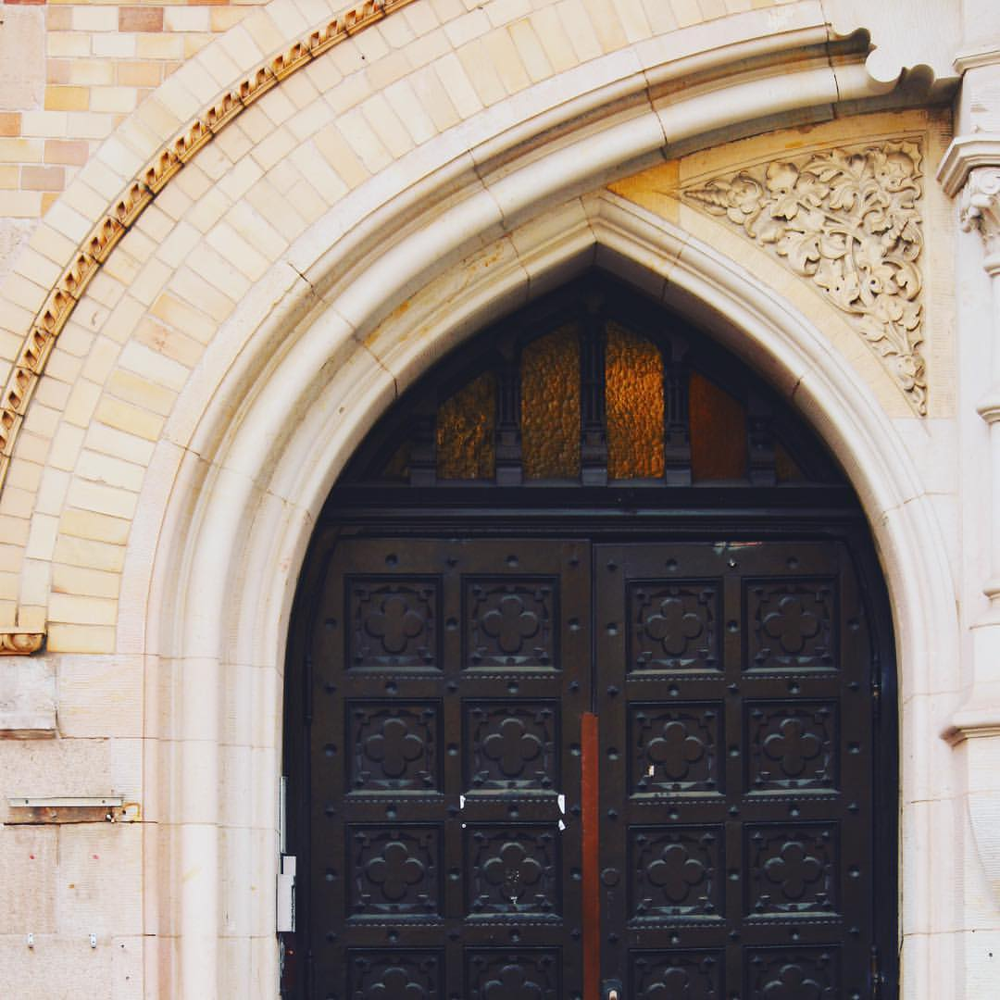

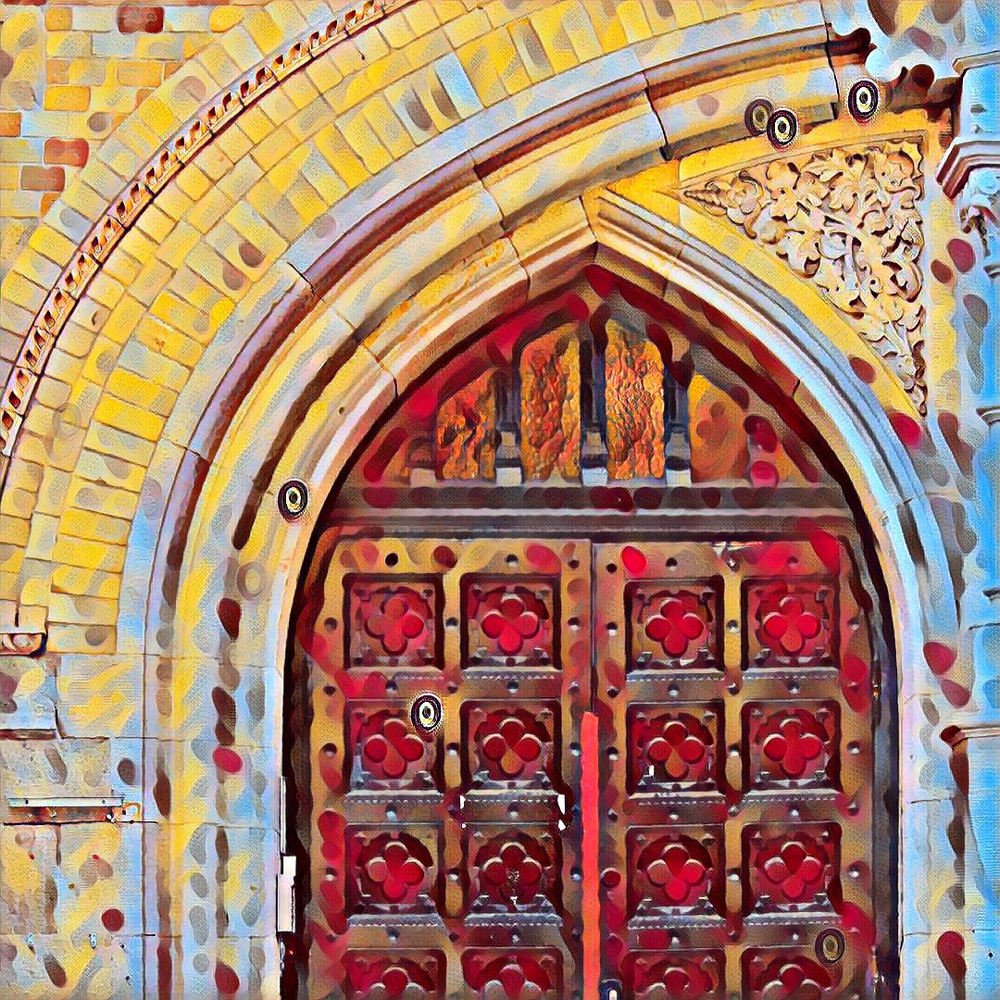

In [7]:
from google.colab.patches import cv2_imshow
import cv2

def show_image(filename):
  img = cv2.imread(filename, cv2.IMREAD_UNCHANGED)
  cv2_imshow(img)

# show original image provided with the example
show_image(input_content_sample)
# show the generated output (from previous cell)
show_image(output_filename)

## Try to go slightly deeper and Customize the Inference

### Look at the various functions rather than one-line bash code to excute the python script as black box

#### 0) import the transformernet definition and see the structure

In [8]:
import neural_style
print(neural_style)

<module 'neural_style' from '/content/examples/fast_neural_style/neural_style/__init__.py'>


In [9]:
from neural_style import transformer_net
print(transformer_net)

<module 'neural_style.transformer_net' from '/content/examples/fast_neural_style/neural_style/transformer_net.py'>


In [10]:
model = transformer_net.TransformerNet()
model

TransformerNet(
  (conv1): ConvLayer(
    (reflection_pad): ReflectionPad2d((4, 4, 4, 4))
    (conv2d): Conv2d(3, 32, kernel_size=(9, 9), stride=(1, 1))
  )
  (in1): InstanceNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
  (conv2): ConvLayer(
    (reflection_pad): ReflectionPad2d((1, 1, 1, 1))
    (conv2d): Conv2d(32, 64, kernel_size=(3, 3), stride=(2, 2))
  )
  (in2): InstanceNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
  (conv3): ConvLayer(
    (reflection_pad): ReflectionPad2d((1, 1, 1, 1))
    (conv2d): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2))
  )
  (in3): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
  (res1): ResidualBlock(
    (conv1): ConvLayer(
      (reflection_pad): ReflectionPad2d((1, 1, 1, 1))
      (conv2d): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1))
    )
    (in1): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
    (

#### 1) load and transform input image to tensor

In [11]:
# y = model.forwad(x)

In [12]:
# use the same input sample image, input_content_sample
from neural_style import utils
import torch
from torchvision import transforms
import re

# load
device = torch.device("cuda")
content_image = utils.load_image(input_content_sample)
# transform
content_transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Lambda(lambda x: x.mul(255))
])
content_image = content_transform(content_image)
content_image = content_image.unsqueeze(0).to(device)

#### 2) run forward pass and compute the output of the transformernet

In [13]:
# create model from TransformerNet and load checkpoint
with torch.no_grad():
    model = transformer_net.TransformerNet()
    state_dict = torch.load(checkpoint)

    # remove saved deprecated running_* keys in InstanceNorm from the checkpoint
    for k in list(state_dict.keys()):
        if re.search(r'in\d+\.running_(mean|var)$', k):
            del state_dict[k]

    model.load_state_dict(state_dict)
    model.to(device)
    model.eval()

    output = model(content_image).cpu()

#### 3) save the output tensor as image and display

In [14]:
 output_sample = "images/output-images/newoutput_go_deeper.jpg"

 utils.save_image(output_sample, output[0])

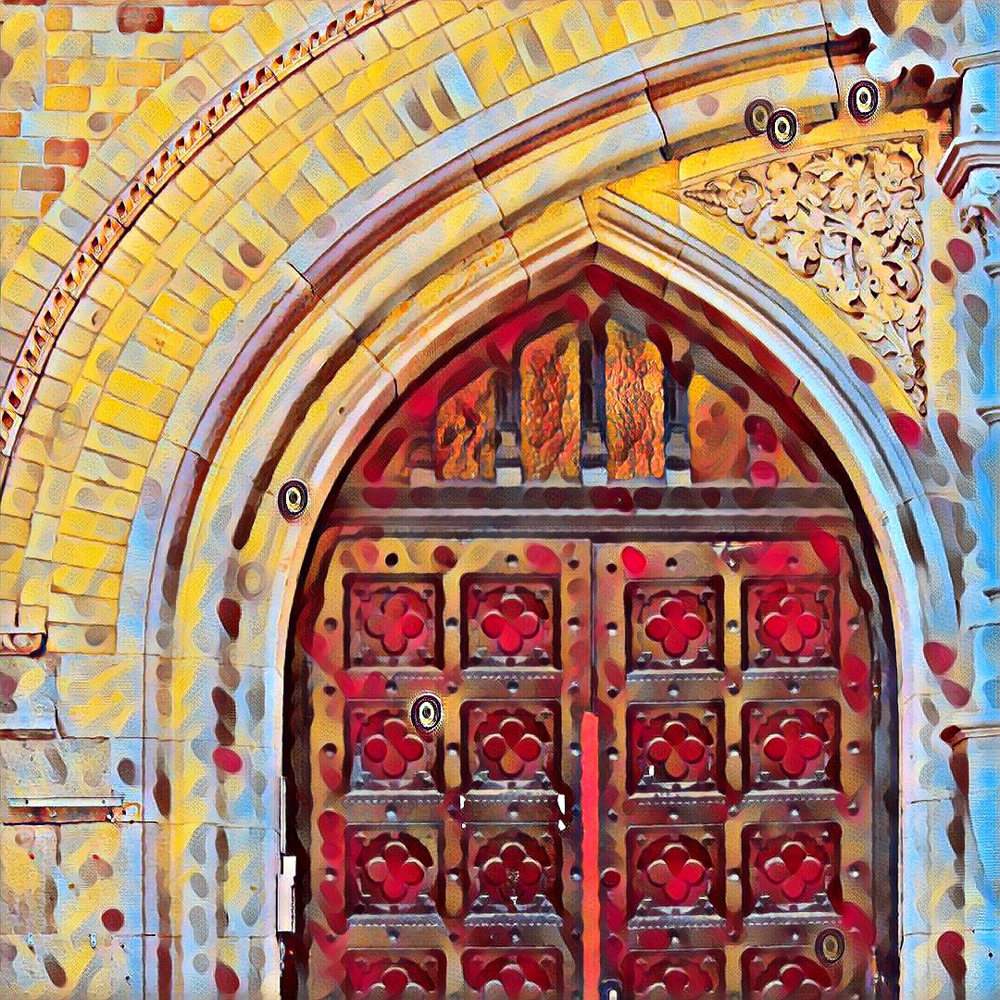

In [15]:
show_image(output_sample)

#### 4) let's wrap it up as a function to run the inference

In [16]:
# use the same input sample image, input_content_sample
from neural_style import utils
from neural_style import transformer_net

import torch
from torchvision import transforms
import re, time

device = torch.device("cuda")
content_transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Lambda(lambda x: x.mul(255))
])
def inference_style_model(content_filename, checkpoint_path,output_filename):

  # create model from TransformerNet and load checkpoint
    init_time_stamp = time.time()
    
    model = transformer_net.TransformerNet()
    state_dict = torch.load(checkpoint)
    
    # remove saved deprecated running_* keys in InstanceNorm from the checkpoint
    for k in list(state_dict.keys()):
        if re.search(r'in\d+\.running_(mean|var)$', k):
            del state_dict[k]
    
    # load checkpoint and move to cuda
    model.load_state_dict(state_dict)
    model.to(device)
    model.eval()

    #  freeze gradient
    for param in model.parameters():
      param.requires_grad = False

    start_time_stamp = time.time()
    print("initilize the model take time {:.4f}".format(start_time_stamp - init_time_stamp))
    
    # load image
    content_image = utils.load_image(input_content_sample)
    # transform
    content_image = content_transform(content_image)
    content_image = content_image.unsqueeze(0).to(device)
    
    load_time_stamp = time.time()
    print("load the content image take time {:.4f}".format(load_time_stamp - start_time_stamp))
    
    # compute the result and move to cpu
    output = model(content_image)
    
    inference_time_stamp = time.time()
    print("inference the content image take time {:.4f}".format(inference_time_stamp - load_time_stamp))
    
    # move tensor to cpu 
    output = output.cpu()
    
    tocpu_time_stamp = time.time()
    print("convert the content image to cpu take time {:.4f}".format(tocpu_time_stamp - inference_time_stamp))
    
    # convert and save image
    output = output[0]
    utils.save_image(output_filename, output)
    
    save_time_stamp = time.time()
    print("save the content image take time {:.4f}".format(save_time_stamp - tocpu_time_stamp))
    return output


initilize the model take time 0.0307
load the content image take time 0.0428
inference the content image take time 0.0057
convert the content image to cpu take time 0.1149
save the content image take time 0.0870


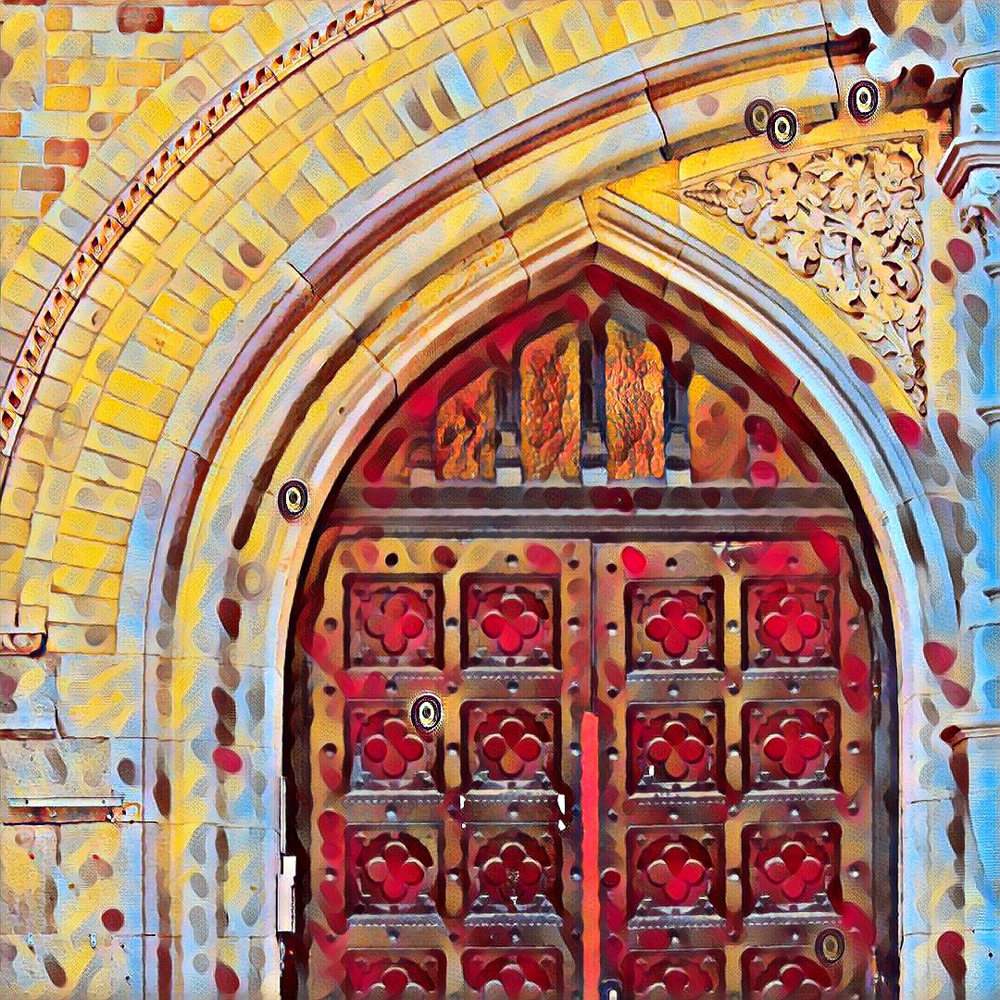

In [17]:
 output_filename = "images/output-images/newoutput_go_deeper_func.jpg"
 output = inference_style_model(input_content_sample, checkpoint, output_filename)
 show_image(output_filename)

## Train the network with new style image
#### keep use the defined model architecture and try to implement the loss and training process

#### 1) Work with Provided bash command and training function

#### download and unzip the coco dataset first

In [30]:
# coco dataset: http://images.cocodataset.org/zips/train2014.zip
# this may take time based on the internet connection (not yours, but the colab notebook sever to coco dataset server)
!wget http://images.cocodataset.org/zips/train2014.zip

--2022-04-06 07:47:08--  http://images.cocodataset.org/zips/train2014.zip
Resolving images.cocodataset.org (images.cocodataset.org)... 52.216.105.67
Connecting to images.cocodataset.org (images.cocodataset.org)|52.216.105.67|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 13510573713 (13G) [application/zip]
Saving to: ‘train2014.zip’

train2014.zip       100%[===================>]  12.58G  16.7MB/s    in 18m 13s 

2022-04-06 08:05:21 (11.8 MB/s) - ‘train2014.zip’ saved [13510573713/13510573713]



In [36]:
# unzip the files
import zipfile
source_filename = '/content/examples/fast_neural_style/train2014.zip'
dest_dir = "/content/examples/fast_neural_style/images/dataset/"

with zipfile.ZipFile(source_filename) as zf:
    zf.extractall(path=dest_dir)

#### train with provide bash command

In [38]:
# train the model
! mkdir trained_models
! python neural_style/neural_style.py train --dataset /content/examples/fast_neural_style/images/dataset/ --style-image /content/examples/fast_neural_style/images/output-images/newoutput_go_deeper.jpg --save-model-dir trained_models/ --epochs 2 --cuda 1 

mkdir: cannot create directory ‘trained_models’: File exists
Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth
100% 528M/528M [00:02<00:00, 221MB/s]
Wed Apr  6 08:14:34 2022	Epoch 1:	[2000/82783]	content: 857083.578500	style: 1441913.040938	total: 2298996.619437
Wed Apr  6 08:16:19 2022	Epoch 1:	[4000/82783]	content: 815219.319063	style: 870092.333047	total: 1685311.652109
Wed Apr  6 08:18:04 2022	Epoch 1:	[6000/82783]	content: 772090.148667	style: 660235.653990	total: 1432325.802656
Wed Apr  6 08:19:50 2022	Epoch 1:	[8000/82783]	content: 737478.679594	style: 549108.581133	total: 1286587.260727
Wed Apr  6 08:21:36 2022	Epoch 1:	[10000/82783]	content: 709433.793638	style: 480449.534706	total: 1189883.328344
Wed Apr  6 08:23:21 2022	Epoch 1:	[12000/82783]	content: 686337.900229	style: 432822.665422	total: 1119160.565651
Wed Apr  6 08:25:06 2022	Epoch 1:	[14000/82783]	content: 666733.410125	style: 398382.045585	t

#### Inference with the trained model

initilize the model take time 0.0368
load the content image take time 0.0491
inference the content image take time 0.0062
convert the content image to cpu take time 0.1265
save the content image take time 0.0844


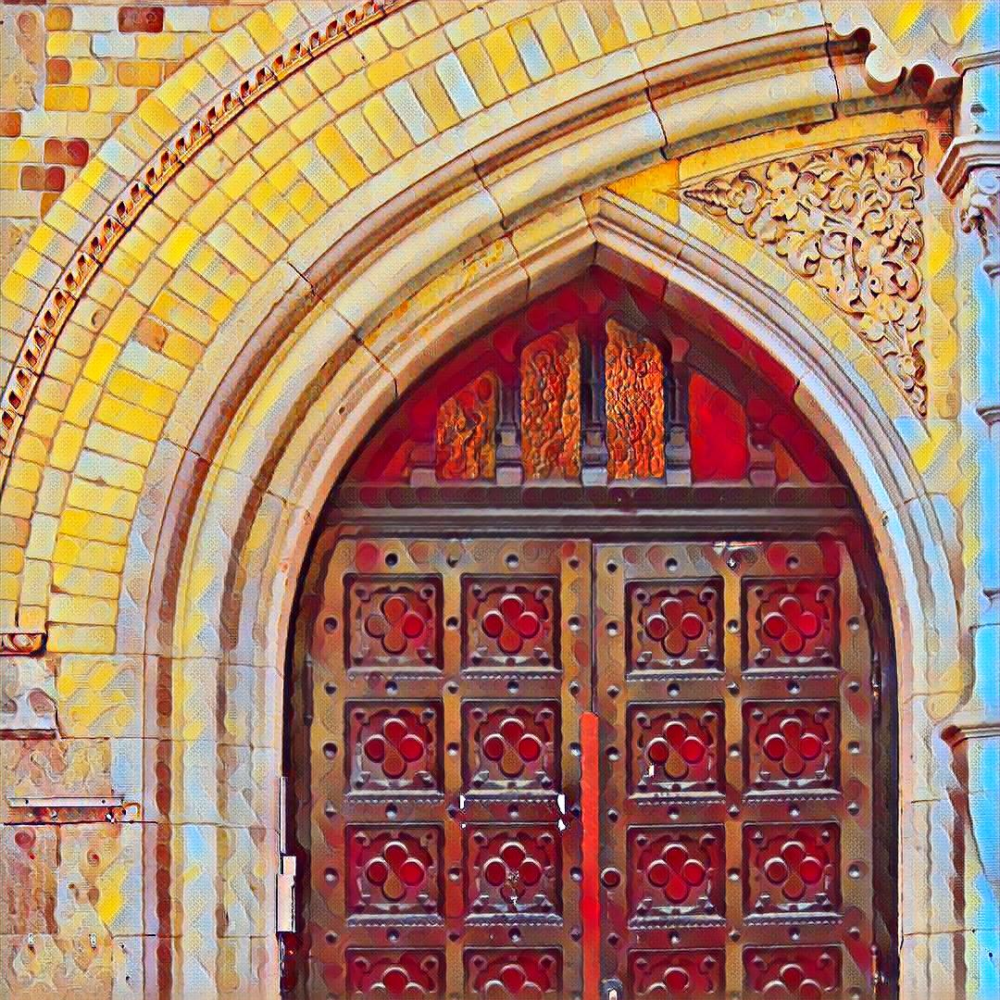

In [40]:
 checkpoint = "trained_models/{}".format("epoch_2_Wed_Apr__6_10:21:18_2022_100000.0_10000000000.0.model")
 output_filename = "images/output-images/newoutput_trained_candy_model.jpg"
 output = inference_style_model(input_content_sample, checkpoint, output_filename)
 show_image(output_filename)

#### train and inference antoher style image

In [52]:
! python neural_style/neural_style.py train --dataset /content/examples/fast_neural_style/images/dataset/ --style-image /content/examples/fast_neural_style/images/style-images/mosaic.jpg --save-model-dir trained_models/mosaic/ --epochs 2 --cuda 1 --checkpoint-model-dir trained_models/mosaic

Wed Apr  6 11:44:07 2022	Epoch 1:	[2000/82783]	content: 1482012.646625	style: 5263184.564250	total: 6745197.210875
Wed Apr  6 11:45:48 2022	Epoch 1:	[4000/82783]	content: 1540808.826812	style: 3098990.187063	total: 4639799.013875
Wed Apr  6 11:47:30 2022	Epoch 1:	[6000/82783]	content: 1529373.947708	style: 2270992.055812	total: 3800366.003521
Wed Apr  6 11:49:12 2022	Epoch 1:	[8000/82783]	content: 1502664.832469	style: 1825944.728438	total: 3328609.560906
Wed Apr  6 11:50:56 2022	Epoch 1:	[10000/82783]	content: 1473392.004225	style: 1546164.455625	total: 3019556.459850
Wed Apr  6 11:52:39 2022	Epoch 1:	[12000/82783]	content: 1445364.100313	style: 1353900.644458	total: 2799264.744771
Wed Apr  6 11:54:21 2022	Epoch 1:	[14000/82783]	content: 1419906.055589	style: 1213751.828107	total: 2633657.883696
Wed Apr  6 11:56:04 2022	Epoch 1:	[16000/82783]	content: 1398783.356766	style: 1108945.713703	total: 2507729.070469
Wed Apr  6 11:57:45 2022	Epoch 1:	[18000/82783]	content: 1379423.078458	styl

#### inference with .model

initilize the model take time 0.0355
load the content image take time 0.0532
inference the content image take time 0.0055
convert the content image to cpu take time 0.1271
save the content image take time 0.0735


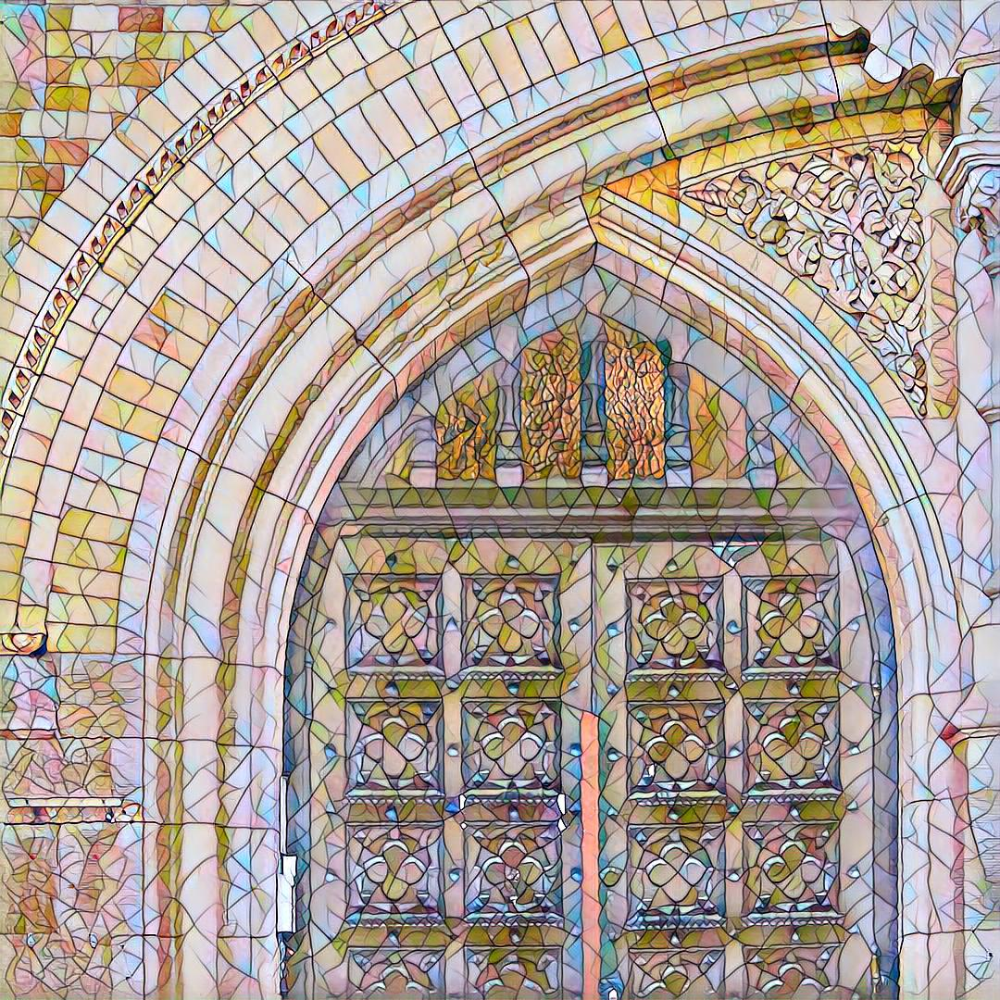

In [54]:
# epoch_2_Wed_Apr__6_13:49:51_2022_100000.0_10000000000.0.model

checkpoint = "trained_models/mosaic/{}".format("epoch_2_Wed_Apr__6_13:49:51_2022_100000.0_10000000000.0.model")
output_filename = "images/output-images/newoutput_trained_mosaic.jpg"
output = inference_style_model(input_content_sample, checkpoint, output_filename)
show_image(output_filename)

#### Inference with pth file

initilize the model take time 0.0328
load the content image take time 0.0375
inference the content image take time 0.0045
convert the content image to cpu take time 0.1234
save the content image take time 0.0723


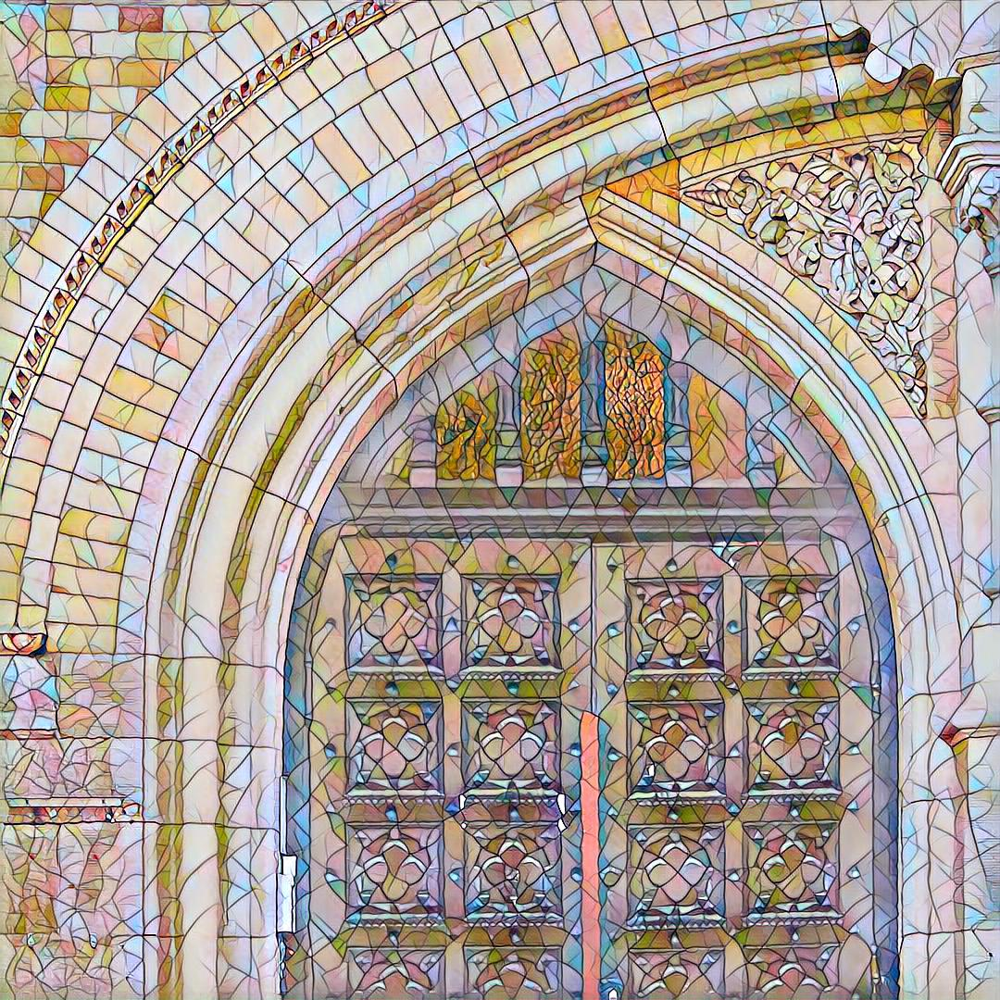

In [55]:
checkpoint = "trained_models/mosaic/{}".format("ckpt_epoch_1_batch_id_8000.pth")
output_filename = "images/output-images/newoutput_trained_mosaic_pth.jpg"
output = inference_style_model(input_content_sample, checkpoint, output_filename)
show_image(output_filename)

#### format the inference line, make it easier to read
#### with colab magic cell & break args into multiple lines

In [57]:
%%shell

args=(
  train
  --dataset /content/examples/fast_neural_style/images/dataset/ 
  --style-image /content/examples/fast_neural_style/images/style-images/udnie.jpg
  --save-model-dir trained_models/udnie/ 
  --epochs 2 
  --cuda 1 
  --checkpoint-model-dir trained_models/udnie/ 
    )

python neural_style/neural_style.py "${args[@]}"

Wed Apr  6 14:21:20 2022	Epoch 1:	[2000/82783]	content: 420606.631594	style: 312616.183828	total: 733222.815422
Traceback (most recent call last):
  File "neural_style/neural_style.py", line 249, in <module>
    main()
  File "neural_style/neural_style.py", line 243, in main
    train(args)
  File "neural_style/neural_style.py", line 67, in train
    for batch_id, (x, _) in enumerate(train_loader):
  File "/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py", line 521, in __next__
    data = self._next_data()
  File "/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py", line 561, in _next_data
    data = self._dataset_fetcher.fetch(index)  # may raise StopIteration
  File "/usr/local/lib/python3.7/dist-packages/torch/utils/data/_utils/fetch.py", line 49, in fetch
    data = [self.dataset[idx] for idx in possibly_batched_index]
  File "/usr/local/lib/python3.7/dist-packages/torch/utils/data/_utils/fetch.py", line 49, in <listcomp>
    data = [self.dat

CalledProcessError: ignored

## 2) Go deeper and construct the training script with defined transformernet

#### First to figure out the loss and network structure